# Regular expressions

In [10]:
import re

# Test text from the exercise
test_text = """
Tousled try-hard blog Carles, typewriter fap hella salvia fanny pack selvage mlkshk crucifix. 
Next level retro quinoa post-ironic. Heirloom keffiyeh synth street art meggings, drinking vinegar 
Schlitz actually raw denim. 1234 Normcore freegan post-ironic meggings cred, cardigan yr locavore 
3 wolf moon. Bitters ennui ugh superpolaroid, artisan scenester distillery kale chips wolf pork 
belly keffiyeh. Actually Tumblr twee [[drinking vinegar]], squid pickled cronut banh mi taxidermy 
deep v 8-bit narwhal Odd Future. Sriracha bicycle rights listicle, keffiyeh typewriter authentic 
selvage cred selfies.

Ugh lo-fi tattooed chambray, DIY Marfa banh mi whatever narwhal jean shorts photo booth keytar 
listicle. Chambray Truffaut cardigan skateboard, hashtag disrupt next level. Normcore Blue Bottle 
yr, Odd Future skateboard chillwave iPhone slow-carb sriracha letterpress meditation cronut. IPhone 
fashion axe Neutra fingerstache tofu gluten-free [[gentrify]], wolf before they sold out pork belly 
retro Vice skateboard DIY Marfa. Mustache supertaxidermy cliche 9999 fashion axe Pitchfork, iPhone 
cred literally McSweeney's normcore. Health goth meggings skateboard 90's 3 wolf moon, PBR&B kale 
chips biodiesel fashion axe. Sartorial crucifix retro, four dollar toast kogi forage swag deep v 
wayfarers tilde.

Synth typewriter messenger bag health goth scenester pour-over. Pour-over Truffaut 90's fashion axe 
post-ironic, Portland Wes Anderson forage occupy sartorial gentrify hashtag beard kitsch quinoa. 
Occupy [[hashtag]] street art 3 wolf moon, Echo Park quinoa Tumblr Pitchfork fanny pack High Life. 
Helvetica banjo gentrify authentic mumblecore, tote bag blog. Scenester +1 American Apparel organic 
literally, Intelligentsia butcher bitters. Seitan lumbersexual fanny pack organic, letterpress umami 
ethical wayfarers. Cronut biodiesel Wes Anderson, jean shorts lo-fi keffiyeh Carles.

Bushwick health goth chambray gluten-free distillery. Keytar selvage Shoreditch, seitan YOLO tote 
bag listicle Marfa farm-to-table keffiyeh meditation tilde. Narwhal freegan meditation, Pitchfork 
XOXO Brooklyn 23456 whatever photo booth pork belly Blue Bottle gluten-free. Semiotics fashion axe 
3 wolf moon, selfies brunch skateboard shabby chic organic wayfarers yr whatever kitsch Thundercats 
tilde bespoke. [[Bicycle|Bicycle(two-wheeled type)]] rights seitan mlkshk Marfa, church-key cray 
mustache sartorial banh mi food truck chillwave Echo Park bitters. Craft superbeer bespoke street 
art, slow-carb pop-up Kickstarter typewriter Etsy try-hard [[Pitchfork|Pitchfork Magazine]] 
aesthetic keytar Tumblr. 8-bit bitters fanny pack, Portland Odd Future yr selvage crucifix narwhal 
polaroid sriracha Thundercats.
"""

# 1. Find all four-digit numbers
four_digit_numbers = re.findall(r'\b\d{4}\b', test_text)
print("Four-digit numbers found:", four_digit_numbers)

# 2. Find all words starting with "super"
super_words = re.findall(r'\bsuper\w*', test_text)
print("Words starting with 'super':", super_words)

# 3. Extract internal Wikipedia links
wiki_links = re.findall(r'\[\[(.*?)\]\]', test_text)
extracted_links = []

for link in wiki_links:
    # Handle both types of wiki links ([[link]] and [[link|display]])
    if '|' in link:
        page, display = link.split('|')
        extracted_links.append((page, display))
    else:
        extracted_links.append((link, link))

# Print extracted links
print("Extracted wiki links (page, display):")
for link in extracted_links:
    print(link)



Four-digit numbers found: ['1234', '9999']
Words starting with 'super': ['superpolaroid', 'supertaxidermy', 'superbeer']
Extracted wiki links (page, display):
('drinking vinegar', 'drinking vinegar')
('gentrify', 'gentrify')
('hashtag', 'hashtag')
('Bicycle', 'Bicycle(two-wheeled type)')
('Pitchfork', 'Pitchfork Magazine')


In [12]:
# Load the cleaned text file
with open('Assignment 1/artists.txt', 'r', encoding='utf-8') as file:
    text = file.read()

# Regex to extract internal Wikipedia links
wiki_links = re.findall(r'\[\[(.*?)\]\]', text)

extracted_links = []
for link in wiki_links:
    if '|' in link:
        page, display = link.split('|')
        extracted_links.append((page, display))
    else:
        extracted_links.append((link, link))

# Print the extracted Wikipedia links
print("Extracted wiki links (page, display):")
for link in extracted_links:
    print(link)


Extracted wiki links (page, display):
('4 Runner', '4 Runner')
('8 Ball Aitken', '8 Ball Aitken')
('The Abrams Brothers', 'The Abrams Brothers')
('Ace in the Hole Band', 'Ace in the Hole Band')
('Roy Acuff', 'Roy Acuff')
('Kay Adams (singer)', 'Kay Adams')
('Ryan Adams', 'Ryan Adams')
('Doug Adkins', 'Doug Adkins')
('Trace Adkins', 'Trace Adkins')
('David "Stringbean" Akeman', 'David "Stringbean" Akeman')
('Rhett Akins', 'Rhett Akins')
('Alabama (band)', 'Alabama')
('Lauren Alaina', 'Lauren Alaina')
('Jason Aldean', 'Jason Aldean')
('Alee (singer)', 'Alee')
('Daniele Alexander', 'Daniele Alexander')
('Jessi Alexander', 'Jessi Alexander')
('Gary Allan', 'Gary Allan')
('Susie Allanson', 'Susie Allanson')
('Deborah Allen', 'Deborah Allen')
('Duane Allen', 'Duane Allen')
('Harley Allen', 'Harley Allen')
('Jimmie Allen', 'Jimmie Allen')
('Rex Allen', 'Rex Allen')
('Terry Allen (country singer)', 'Terry Allen')
('Allman Brothers Band', 'Allman Brothers Band')
('Gregg Allman', 'Gregg Allman')

Go to the page https://en.wikipedia.org/wiki/List_of_country_music_performers and extract all of the links using your regular expressions from above.
Hint: To make this easy, you can simply hit the edit button on wikipedia, copy the entire content of the file to a plain text file on your computer and manually delete all of the markup that's not related to the artists' names.

In [13]:
import os
import requests

# Wikipedia API URL
WIKI_API_URL = "https://en.wikipedia.org/w/api.php"

# Function to sanitize file names by replacing or removing invalid characters
def sanitize_filename(name):
    # Replace slashes and other invalid characters with underscores or nothing
    return name.replace("/", "_").replace("\\", "_").replace(":", "_")

# Assume extracted_links is already filled with (page_name, display_name)
# You can use the code you provided earlier to fill the extracted_links list.

# Create a directory to store the text files
if not os.path.exists("country_music_performers"):
    os.makedirs("country_music_performers")

# Function to fetch wikitext from the Wikipedia API
def fetch_wikitext(page_title):
    params = {
        "action": "query",
        "format": "json",
        "prop": "revisions",
        "titles": page_title,
        "rvprop": "content",
        "rvslots": "main"
    }
    response = requests.get(WIKI_API_URL, params=params)
    data = response.json()
    
    # Extract page data
    page = next(iter(data['query']['pages'].values()))
    if 'revisions' in page:
        return page['revisions'][0]['slots']['main']['*']
    else:
        print(f"Page '{page_title}' not found.")
        return None

# Download and save the wikitext for each performer
for page, display in extracted_links:
    page = page.replace(" ", "_")  # Replace spaces with underscores for Wikipedia API
    sanitized_filename = sanitize_filename(page)  # Sanitize file name
    
    wikitext = fetch_wikitext(page)
    
    if wikitext:
        # Save the wikitext to a file named after the performer
        file_path = os.path.join("country_music_performers", f"{sanitized_filename}.txt")
        with open(file_path, "w", encoding="utf-8") as file:
            file.write(wikitext)


KeyboardInterrupt: 

In [14]:
# Path to the directory where the performers' files are stored
directory_path = '/Users/victorwintherlarsen/socialgraphs/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Get the list of files in the directory
performers_files = os.listdir(directory_path)

# Print the number of files (performers)
print(len(performers_files))


2090


# Part 2: Building the networks

The overall plan of attack for this is the following:

Take the pages you have downloaded for each performer.
Each page corresponds to a performer, which is a node in your network.
Find all the hyperlinks in a performers page that link to another node of the network (e.g. an other perfomer).
There are many ways to do this, but below, I've tried to break it down into natural steps.

In [16]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/victorwintherlarsen/socialgraphs/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Load the list of performer names (we'll use this to verify links)
performers = {
    "4_Runner": "4 Runner",
    "8_Ball_Aitken": "8 Ball Aitken",
    # Add more performers from your dataset...
}

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Check if a link points to another performer
def is_performer_link(link, performers):
    # Get the page name (before the pipe '|' if it exists)
    page_name = link.split('|')[0]
    return page_name in performers

# Process a single performer page
def process_single_performer(performer_file, performers):
    wikitext = load_performer_page(performer_file)
    links = extract_links(wikitext)
    
    # Filter out links that are not performers
    performer_links = [link for link in links if is_performer_link(link, performers)]
    
    return performer_links

# Example with a single performer (e.g. "3_of_Hearts_(band).txt")
performer_file = os.path.join(directory_path, '4_Runner.txt')

# Process the single performer page
outgoing_links = process_single_performer(performer_file, performers)

wikitext = load_performer_page(performer_file)
links = extract_links(wikitext)

# Print the outgoing links
print(f"Outgoing links from 4_runner: {links}")


Outgoing links from 4_runner: ['Nashville, Tennessee', 'Country music|Country', 'Polydor Records|Polydor Nashville', 'A&M Records|A&M', 'country music', 'Nashville, Tennessee', 'Polydor Records', '4 Runner (album)|self-titled', 'Hot Country Songs', "Cain's Blood", 'A&M Records', 'Nashville, Tennessee', 'Tanya Tucker', 'Billboard (magazine)|Billboard', 'Steven Curtis Chapman', 'Diamond Rio', 'Love a Little Stronger (song)|Love a Little Stronger', 'Reba McEntire', 'Mercury Records', 'Polydor Records', 'Amie Comeaux', "Cain's Blood", 'Michael Johnson (singer)|Michael Johnson', 'Poco (band)|Poco', 'Great Plains (Tennessee band)|Great Plains', 'Billboard (magazine)|Billboard', 'RPM (magazine)|RPM', 'Hawaiʻi Volcanoes National Park', 'CMT (U.S. TV channel)|CMT', '4 Runner (album)|self-titled debut album', 'Buddy Cannon', 'Marina del Rey, California', 'Chely Wright', 'PolyGram', 'RPM (magazine)|RPM', 'Pine Bluff, Arkansas', 'Gavin Report', 'A&M Records', 'Keith Urban', 'Broadcast Music Incorp

In [17]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/victorwintherlarsen/socialgraphs/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Step 1: Automatically load performer names from the files in the directory
performers = {}
for performer_file in os.listdir(directory_path):
    if performer_file.endswith(".txt"):  # Only process .txt files
        # Extract the performer name (without the .txt extension)
        performer_name = os.path.splitext(performer_file)[0]
        performers[performer_name] = performer_name  # Store in the dictionary

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Normalize performer name (remove spaces, underscores, and handle case)
def normalize_name(name):
    # Convert to lowercase, replace spaces and underscores with a standard form (e.g., underscores)
    return name.strip().replace(" ", "_").replace("-", "_")

# Initialize a directed graph
G = nx.DiGraph()

# Process only one performer: 4_Runner
performer_name = '4_Runner'

# Full path to the performer file
performer_file = os.path.join(directory_path, performer_name + '.txt')

# Load the performer's wikitext
wikitext = load_performer_page(performer_file)

# Print raw wikitext for debugging
print(f"Wikitext for {performer_name}:")
print(wikitext[:500])  # Print first 500 characters of the wikitext for verification

# Add the performer as a node to the graph
G.add_node(performer_name)

# Extract links from the wikitext
links = extract_links(wikitext)

# Print the extracted raw links for verification
print(f"Extracted links for {performer_name}: {links}")

# Add edges for outgoing links to other performers
for link in links:
    # Extract the linked page name
    linked_performer = link.split('|')[0]

    # Normalize the linked performer name and current performer name for comparison
    normalized_linked_performer = normalize_name(linked_performer)
    normalized_performer_name = normalize_name(performer_name)

    # Print the normalized names for verification
    print(f"Checking link: {linked_performer} -> Normalized: {normalized_linked_performer}")

    # Check if the linked performer is in the performers list after normalization
    if normalized_linked_performer in performers:
        # Add the edge to the graph
        G.add_edge(normalized_performer_name, normalized_linked_performer)
        print(f"Added edge: {normalized_performer_name} -> {normalized_linked_performer}")
    else:
        print(f"Link {normalized_linked_performer} not found in performers.")

# Print the graph information for 4_Runner
print(f"Nodes in the graph: {G.nodes()}")
print(f"Edges in the graph: {G.edges()}")


Wikitext for 4_Runner:
{{Short description|American country music vocal group}}
{{about|an American country music group|the car of the same name|Toyota 4Runner}}
{{Infobox musical artist
| name            = 4 Runner
| image           = 4 Runner.jpg
| caption         = Promotional picture of 4Runner, 1995. L-R: Lee Hillard, Craig Morris, Billy Crittenden, and Jim Chapman.
| origin          = [[Nashville, Tennessee]], U.S.
| genre           = [[Country music|Country]]
| years_active    = 1993-1996, 2002-05, 2023-present
Extracted links for 4_Runner: ['Nashville, Tennessee', 'Country music|Country', 'Polydor Records|Polydor Nashville', 'A&M Records|A&M', 'country music', 'Nashville, Tennessee', 'Polydor Records', '4 Runner (album)|self-titled', 'Hot Country Songs', "Cain's Blood", 'A&M Records', 'Nashville, Tennessee', 'Tanya Tucker', 'Billboard (magazine)|Billboard', 'Steven Curtis Chapman', 'Diamond Rio', 'Love a Little Stronger (song)|Love a Little Stronger', 'Reba McEntire', 'Mercury 

In [18]:
import re
import os
import networkx as nx

# Directory where the performer files are stored
directory_path = '/Users/victorwintherlarsen/socialgraphs/Social-Graphs-And-Interactions/Assignment 1/country_music_performers'

# Step 1: Automatically load performer names from the files in the directory
performers = {}
for performer_file in os.listdir(directory_path):
    if performer_file.endswith(".txt"):  # Only process .txt files
        # Extract the performer name (without the .txt extension)
        performer_name = os.path.splitext(performer_file)[0]
        performers[performer_name] = performer_name  # Store in the dictionary

# Function to load a file (performer's wikitext)
def load_performer_page(performer_filename):
    with open(performer_filename, 'r', encoding='utf-8') as file:
        return file.read()

# Function to extract links from the wikitext
def extract_links(wikitext):
    # Regex to extract links in the format [[link]] or [[link|display]]
    return re.findall(r'\[\[(.*?)\]\]', wikitext)

# Check if a link points to another performer
def is_performer_link(link, performers):
    # Get the page name (before the pipe '|' if it exists)
    page_name = link.split('|')[0]
    return page_name in performers

# Function to count words in the performer's page (excluding symbols)
def count_words_in_page(wikitext):
    # Remove special characters and count words
    words = re.findall(r'\b\w+\b', wikitext)
    return len(words)

# Initialize a directed graph
G = nx.DiGraph()

# Normalize performer name (remove spaces, underscores, and handle case)
def normalize_name(name):
    # Convert to lowercase, replace spaces and underscores with a standard form (e.g., underscores)
    return name.strip().replace(" ", "_").replace("-", "_")



# Process each performer file
for performer_file in os.listdir(directory_path):
    # Full path to the performer file
    full_file_path = os.path.join(directory_path, performer_file)
    
    # Extract performer name (without the .txt extension)
    performer_name = os.path.splitext(performer_file)[0]

    print(f"Processing performer: {performer_name}")
    
    # Load the performer's wikitext
    wikitext = load_performer_page(full_file_path)
    
    # Add the performer as a node to the graph
    G.add_node(performer_name)
    
    # Store the content length as a node attribute
    word_count = count_words_in_page(wikitext)
    G.nodes[performer_name]['content_length'] = word_count

    # Extract links from the wikitext
    links = extract_links(wikitext)
    
    
    # Add edges for outgoing links to other performers
    for link in links:
        # Extract the linked page name
        linked_performer = link.split('|')[0]

        # Normalize the linked performer name and current performer name for comparison
        normalized_linked_performer = normalize_name(linked_performer)
        normalized_performer_name = normalize_name(performer_name)
        # Debugging print to check the normalized names
        print(f"Processing link: {linked_performer} -> Normalized: {normalized_linked_performer}")


        # Check if the linked performer is in the performers list after normalization
        if normalized_linked_performer in performers:
            G.add_edge(normalized_performer_name, normalized_linked_performer)



# Print the number of nodes and edges
print(f"Number of nodes: {len(G.nodes())}")
print(f"Number of edges: {len(G.edges())}")



Processing performer: Harry_McClintock
Processing link: Uhrichsville, Ohio -> Normalized: Uhrichsville,_Ohio
Processing link: San Francisco -> Normalized: San_Francisco
Processing link: The Big Rock Candy Mountains -> Normalized: The_Big_Rock_Candy_Mountains
Processing link: Hallelujah, I'm a Bum -> Normalized: Hallelujah,_I'm_a_Bum
Processing link: Hobo -> Normalized: Hobo
Processing link: author -> Normalized: author
Processing link: poet -> Normalized: poet
Processing link: busker -> Normalized: busker
Processing link: cowboy -> Normalized: cowboy
Processing link: union organizer -> Normalized: union_organizer
Processing link: The Big Rock Candy Mountains -> Normalized: The_Big_Rock_Candy_Mountains
Processing link: Uhrichsville, Ohio -> Normalized: Uhrichsville,_Ohio
Processing link: Boxer Rebellion -> Normalized: Boxer_Rebellion
Processing link: Farmington, Utah -> Normalized: Farmington,_Utah
Processing link: KFRC (defunct) -> Normalized: KFRC_(defunct)
Processing link: The Big Ro

Remove isolated nodes

In [19]:
import networkx as nx

# Assuming G is your directed graph (already created)
print(f"Initial number of nodes: {len(G.nodes())}")
print(f"Initial number of edges: {len(G.edges())}")

# Step 1: Find isolated nodes
isolated_nodes = list(nx.isolates(G))

# Print isolated nodes for verification
print(f"Isolated nodes (no in-degree or out-degree): {isolated_nodes}")

# Step 2: Remove isolated nodes
G.remove_nodes_from(isolated_nodes)

# Step 3: Check the number of nodes and edges after removal
print(f"Number of nodes after removing isolated nodes: {len(G.nodes())}")
print(f"Number of edges after removing isolated nodes: {len(G.edges())}")


Initial number of nodes: 2098
Initial number of edges: 17584
Isolated nodes (no in-degree or out-degree): ['Harry_McClintock', 'My_Darling_Clementine_(band)', 'The_Dirt_Drifters', 'Johnny_and_Jonie_Mosby', 'Bobby_Cash_(singer)', 'Travis_Rush', 'Hugo_(musician)', 'Tracey_Brown', 'Cole_Deggs_&_The_Lonesome', 'Kings_County_Queens', 'Folk_Soul_Revival', 'Dasha_(singer)', 'Susan_Haynes', 'Shana_Petrone', 'Lex_Rijger', 'Warner_Mack', 'James_&_Michael_Younger', 'Jason_Meadows', 'Rune_Rudberg', 'Hometown_News', 'The_Spurs', 'Luke_Bell_(musician)', 'Ray_Vega_(singer)', 'Cee_Cee_Chapman', 'Roger_Ballard_(American_singer-songwriter)', 'Herb_Jeffreys', 'Jason_Jones_(country_singer)', 'Joan_Kennedy_(musician)', 'Kylie_Morgan', 'Bobby_G._Rice', 'Kris_Tyler', 'The_Band_of_Heathens', 'Dick_Feller', 'Griffin_Layne', 'Tim_Malchak', 'Possessed_by_Paul_James', 'Simani', 'Elise_Davis', 'JJ_White', 'The_Abrams_Brothers', 'River_Town_Saints', 'Marsha_Thornton', 'Molly_&_the_Heymakers', "Chasin'_Crazy", 'Ray_

extracting the largest component from the graph


In [20]:
# Step 4: Extract the largest weakly connected component (for directed graphs)
largest_component = max(nx.weakly_connected_components(G), key=len)

# Create a subgraph containing only the largest component
G_largest = G.subgraph(largest_component).copy()

# Print the number of nodes and edges in the largest component
print(f"Largest component number of nodes: {len(G_largest.nodes())}")
print(f"Largest component number of edges: {len(G_largest.edges())}")


Largest component number of nodes: 1935
Largest component number of edges: 17577


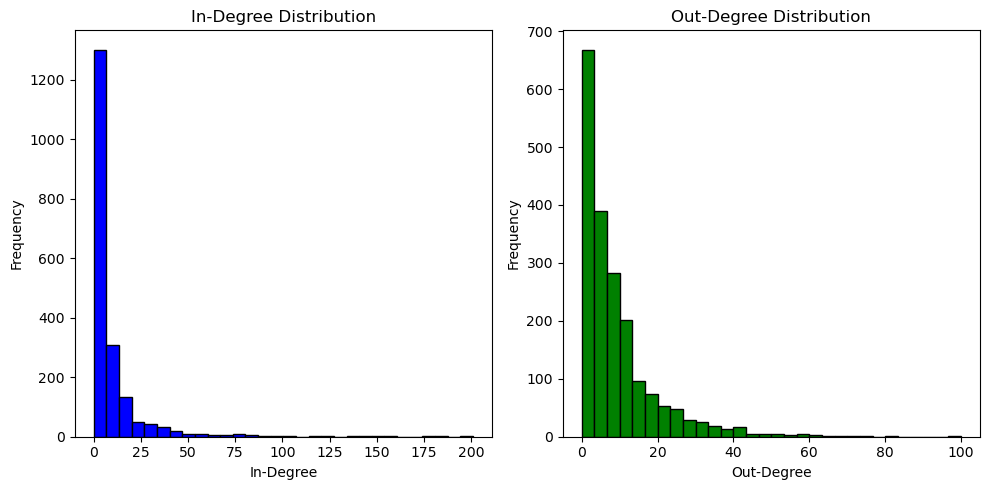

In [21]:
import matplotlib.pyplot as plt
import networkx as nx

# Assuming G is your directed graph

# Step 1: Calculate the in-degree and out-degree for each node
in_degrees = dict(G.in_degree())  # In-degree for each node
out_degrees = dict(G.out_degree())  # Out-degree for each node

# Step 2: Plot the in-degree and out-degree distribution
plt.figure(figsize=(10, 5))

# Plot for in-degree distribution
plt.subplot(1, 2, 1)
plt.hist(in_degrees.values(), bins=30, color='blue', edgecolor='black')
plt.title("In-Degree Distribution")
plt.xlabel("In-Degree")
plt.ylabel("Frequency")

# Plot for out-degree distribution
plt.subplot(1, 2, 2)
plt.hist(out_degrees.values(), bins=30, color='green', edgecolor='black')
plt.title("Out-Degree Distribution")
plt.xlabel("Out-Degree")
plt.ylabel("Frequency")

# Show the plots
plt.tight_layout()
plt.show()


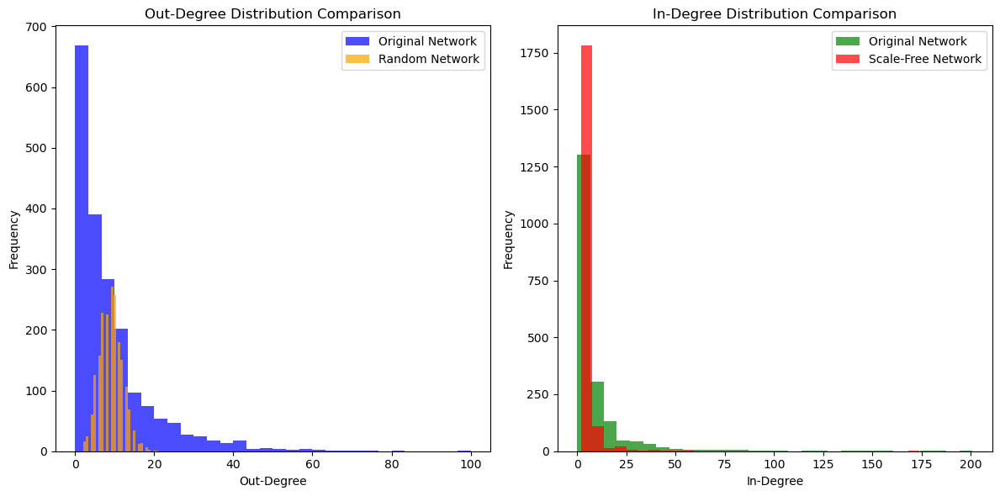

In [22]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Assuming `G` is your original directed graph

# Get the number of nodes and edges
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Create a random network with the same number of nodes and edges
p = num_edges / (num_nodes * (num_nodes - 1))  # Probability for edge creation in a random graph
random_graph = nx.gnp_random_graph(num_nodes, p, directed=True)

# Create a scale-free network with the same number of nodes
scale_free_graph = nx.barabasi_albert_graph(num_nodes, m=2)  # m is the number of edges to attach from a new node to existing nodes

# Out-degree distribution for original and random network
out_degrees_original = [d for _, d in G.out_degree()]
out_degrees_random = [d for _, d in random_graph.out_degree()]

# In-degree distribution for original and scale-free network
in_degrees_original = [d for _, d in G.in_degree()]
in_degrees_scale_free = [d for _, d in scale_free_graph.degree()]

# Plotting Out-degree comparison
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(out_degrees_original, bins=30, alpha=0.7, label='Original Network', color='blue')
plt.hist(out_degrees_random, bins=30, alpha=0.7, label='Random Network', color='orange')
plt.xlabel('Out-Degree')
plt.ylabel('Frequency')
plt.title('Out-Degree Distribution Comparison')
plt.legend()

# Plotting In-degree comparison
plt.subplot(1, 2, 2)
plt.hist(in_degrees_original, bins=30, alpha=0.7, label='Original Network', color='green')
plt.hist(in_degrees_scale_free, bins=30, alpha=0.7, label='Scale-Free Network', color='red')
plt.xlabel('In-Degree')
plt.ylabel('Frequency')
plt.title('In-Degree Distribution Comparison')
plt.legend()

plt.tight_layout()
plt.show()


In [23]:
# Step 1: Calculate the in-degree and out-degree for each node
in_degrees = dict(G.in_degree())  # In-degree for each node
out_degrees = dict(G.out_degree())  # Out-degree for each node

# Step 2: Sort performers by in-degree (from highest to lowest)
top_5_in_degree = sorted(in_degrees.items(), key=lambda x: x[1], reverse=True)[:5]

# Step 3: Sort performers by out-degree (from highest to lowest)
top_5_out_degree = sorted(out_degrees.items(), key=lambda x: x[1], reverse=True)[:5]

# Step 4: Print the top 5 performers for in-degree and out-degree
print("Top 5 performers by In-Degree (most referenced):")
for performer, degree in top_5_in_degree:
    print(f"{performer}: {degree} links")

print("\nTop 5 performers by Out-Degree (most linking to others):")
for performer, degree in top_5_out_degree:
    print(f"{performer}: {degree} links")


Top 5 performers by In-Degree (most referenced):
Willie_Nelson: 201 links
Johnny_Cash: 183 links
Elvis_Presley: 177 links
Dolly_Parton: 160 links
George_Jones: 156 links

Top 5 performers by Out-Degree (most linking to others):
Hillary_Lindsey: 100 links
Pam_Tillis: 82 links
Randy_Travis: 75 links
Vince_Gill: 71 links
Dwight_Yoakam: 67 links


In [24]:
# Sorting the nodes by the length of their wiki content (content_length attribute)
# Assuming the content_length attribute has been added for each performer as in previous steps.

# Step 1: Get the content length attribute for each node
content_lengths = nx.get_node_attributes(G, 'content_length')

# Step 2: Sort by content length (longest first)
top_10_longest_pages = sorted(content_lengths.items(), key=lambda x: x[1], reverse=True)[:10]

# Step 3: Print the top 10 performers with the longest wiki entries
print("Top 10 performers with the longest wiki entries:")
for performer, length in top_10_longest_pages:
    print(f"{performer}: {length} words")


Top 10 performers with the longest wiki entries:
Taylor_Swift: 56352 words
Miley_Cyrus: 51262 words
Justin_Bieber: 50694 words
Carrie_Underwood: 45245 words
Justin_Timberlake: 44775 words
Demi_Lovato: 44189 words
Bob_Dylan: 41087 words
Ed_Sheeran: 36322 words
Elvis_Presley: 33740 words
Tina_Turner: 32873 words


Missing:
Page 'Sherri\'e9_Austin' not found.
Page 'Beyonc\'e9' not found.
Page 'Maggie_Bj\'f6rklund' not found.
Page 'Joanna_Jan\'e9t' not found.
Page 'Elisa_Lindstr\'f6m' not found.
Page 'Toni_Will\'e9' not found.
*[[3 of Hearts (band)|3 of Hearts]]

